In [41]:
# -*- coding: utf-8 -*-
"""
Created on Mon Mar 23 13:30:11 2020

@author: Hong
"""

# %%
# Importing Libraries
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
import seaborn as sns
import matplotlib.gridspec as gridspec
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, \
classification_report, confusion_matrix, precision_recall_curve, \
average_precision_score, roc_curve, auc
from sklearn.model_selection import KFold, StratifiedKFold


In [42]:
# Importing dataset
dataset = pd.read_csv('creditcard.csv')
dataset_X = dataset.iloc[:, 0:30]
dataset_y = dataset.iloc[:, 30]


In [43]:
dataset.info()


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 284807 entries, 0 to 284806
Data columns (total 31 columns):
Time      284807 non-null float64
V1        284807 non-null float64
V2        284807 non-null float64
V3        284807 non-null float64
V4        284807 non-null float64
V5        284807 non-null float64
V6        284807 non-null float64
V7        284807 non-null float64
V8        284807 non-null float64
V9        284807 non-null float64
V10       284807 non-null float64
V11       284807 non-null float64
V12       284807 non-null float64
V13       284807 non-null float64
V14       284807 non-null float64
V15       284807 non-null float64
V16       284807 non-null float64
V17       284807 non-null float64
V18       284807 non-null float64
V19       284807 non-null float64
V20       284807 non-null float64
V21       284807 non-null float64
V22       284807 non-null float64
V23       284807 non-null float64
V24       284807 non-null float64
V25       284807 non-null float64
V26  

In [44]:
dataset.describe()


,Time,V1,V2,V3,V4,V5,V6,V7,V8,V9,...,V21,V22,V23,V24,V25,V26,V27,V28,Amount,Class
count,284807.000000,2.848070e+05,2.848070e+05,2.848070e+05,2.848070e+05,2.848070e+05,2.848070e+05,2.848070e+05,2.848070e+05,2.848070e+05,...,2.848070e+05,2.848070e+05,2.848070e+05,2.848070e+05,2.848070e+05,2.848070e+05,2.848070e+05,2.848070e+05,284807.000000,284807.000000
mean,94813.859575,3.919560e-15,5.688174e-16,-8.769071e-15,2.782312e-15,-1.552563e-15,2.010663e-15,-1.694249e-15,-1.927028e-16,-3.137024e-15,...,1.537294e-16,7.959909e-16,5.367590e-16,4.458112e-15,1.453003e-15,1.699104e-15,-3.660161e-16,-1.206049e-16,88.349619,0.001727
std,47488.145955,1.958696e+00,1.651309e+00,1.516255e+00,1.415869e+00,1.380247e+00,1.332271e+00,1.237094e+00,1.194353e+00,1.098632e+00,...,7.345240e-01,7.257016e-01,6.244603e-01,6.056471e-01,5.212781e-01,4.822270e-01,4.036325e-01,3.300833e-01,250.120109,0.041527
min,0.000000,-5.640751e+01,-7.271573e+01,-4.832559e+01,-5.683171e+00,-1.137433e+02,-2.616051e+01,-4.355724e+01,-7.321672e+01,-1.343407e+01,...,-3.483038e+01,-1.093314e+01,-4.480774e+01,-2.836627e+00,-1.029540e+01,-2.604551e+00,-2.256568e+01,-1.543008e+01,0.000000,0.000000
25%,54201.500000,-9.203734e-01,-5.985499e-01,-8.903648e-01,-8.486401e-01,-6.915971e-01,-7.682956e-01,-5.540759e-01,-2.086297e-01,-6.430976e-01,...,-2.283949e-01,-5.423504e-01,-1.618463e-01,-3.545861e-01,-3.171451e-01,-3.269839e-01,-7.083953e-02,-5.295979e-02,5.600000,0.000000
50%,84692.000000,1.810880e-02,6.548556e-02,1.798463e-01,-1.984653e-02,-5.433583e-02,-2.741871e-01,4.010308e-02,2.235804e-02,-5.142873e-02,...,-2.945017e-02,6.781943e-03,-1.119293e-02,4.097606e-02,1.659350e-02,-5.213911e-02,1.342146e-03,1.124383e-02,22.000000,0.000000
75%,139320.500000,1.315642e+00,8.037239e-01,1.027196e+00,7.433413e-01,6.119264e-01,3.985649e-01,5.704361e-01,3.273459e-01,5.971390e-01,...,1.863772e-01,5.285536e-01,1.476421e-01,4.395266e-01,3.507156e-01,2.409522e-01,9.104512e-02,7.827995e-02,77.165000,0.000000
max,172792.000000,2.454930e+00,2.205773e+01,9.382558e+00,1.687534e+01,3.480167e+01,7.330163e+01,1.205895e+02,2.000721e+01,1.559499e+01,...,2.720284e+01,1.050309e+01,2.252841e+01,4.584549e+00,7.519589e+00,3.517346e+00,3.161220e+01,3.384781e+01,25691.160000,1.000000


In [45]:
dataset.isnull().sum()


Time      0
V1        0
V2        0
V3        0
V4        0
V5        0
V6        0
V7        0
V8        0
V9        0
V10       0
V11       0
V12       0
V13       0
V14       0
V15       0
V16       0
V17       0
V18       0
V19       0
V20       0
V21       0
V22       0
V23       0
V24       0
V25       0
V26       0
V27       0
V28       0
Amount    0
Class     0
dtype: int64

In [46]:
dataset.head()


,Time,V1,V2,V3,V4,V5,V6,V7,V8,V9,...,V21,V22,V23,V24,V25,V26,V27,V28,Amount,Class
0,0.0,-1.359807,-0.072781,2.536347,1.378155,-0.338321,0.462388,0.239599,0.098698,0.363787,...,-0.018307,0.277838,-0.110474,0.066928,0.128539,-0.189115,0.133558,-0.021053,149.62,0
1,0.0,1.191857,0.266151,0.166480,0.448154,0.060018,-0.082361,-0.078803,0.085102,-0.255425,...,-0.225775,-0.638672,0.101288,-0.339846,0.167170,0.125895,-0.008983,0.014724,2.69,0
2,1.0,-1.358354,-1.340163,1.773209,0.379780,-0.503198,1.800499,0.791461,0.247676,-1.514654,...,0.247998,0.771679,0.909412,-0.689281,-0.327642,-0.139097,-0.055353,-0.059752,378.66,0
3,1.0,-0.966272,-0.185226,1.792993,-0.863291,-0.010309,1.247203,0.237609,0.377436,-1.387024,...,-0.108300,0.005274,-0.190321,-1.175575,0.647376,-0.221929,0.062723,0.061458,123.50,0
4,2.0,-1.158233,0.877737,1.548718,0.403034,-0.407193,0.095921,0.592941,-0.270533,0.817739,...,-0.009431,0.798278,-0.137458,0.141267,-0.206010,0.502292,0.219422,0.215153,69.99,0


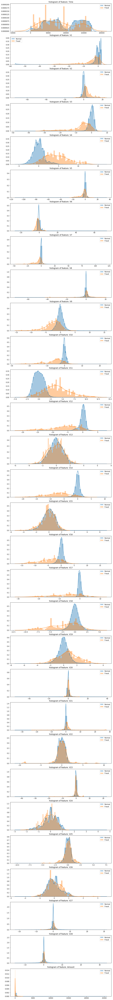

In [47]:
## Select the features
v_features = dataset.iloc[:, 0:30].columns

plt.figure(figsize = (12, 120))
gs = gridspec.GridSpec(30, 1)
for i, cn in enumerate(dataset[v_features]):
    ax = plt.subplot(gs[i])    
    sns.distplot(dataset[cn][dataset.Class == 0], bins = 50, label = 'Normal')
    sns.distplot(dataset[cn][dataset.Class == 1], bins = 50, label = 'Fraud')
    ax.set_xlabel('')
    ax.set_title('histogram of feature: ' + str(cn))
    plt.legend()
plt.show()


In [48]:
X = dataset_X.values
X = X[:, 1:] # Drop 'Time'
y = dataset_y.values


In [49]:
# Splitting the dataset into the Training set and Test set
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.3, shuffle = False)


In [50]:
# Feature Scaling: Only 'Amount'
from sklearn.preprocessing import StandardScaler
sc = StandardScaler()
X_train[:, -1:] = sc.fit_transform(X_train[:, -1:])
X_test[:, -1:] = sc.transform(X_test[:, -1:])


[[85320    15]
 [   52    56]]
accuracy = 0.9992158515033414
precision = 0.7887323943661971
recall = 0.5185185185185185
f1 score = 0.6256983240223464
              precision    recall  f1-score   support

           0       1.00      1.00      1.00     85335
           1       0.79      0.52      0.63       108

   micro avg       1.00      1.00      1.00     85443
   macro avg       0.89      0.76      0.81     85443
weighted avg       1.00      1.00      1.00     85443



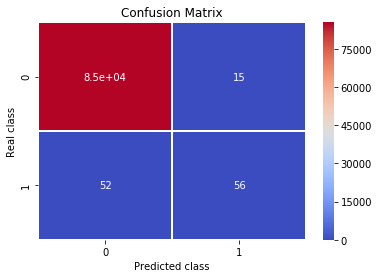

In [51]:
# Fitting the classifier to the Training set: Logistic Regression
from sklearn.linear_model import LogisticRegression
classifier = LogisticRegression(solver = 'liblinear', random_state = 0)
classifier.fit(X_train, y_train)

# Predict Test set
y_pred = classifier.predict(X_test)
cm = confusion_matrix(y_test, y_pred)
print(cm)
print('accuracy = {}'.format(accuracy_score(y_test, y_pred)))
print('precision = {}'.format(precision_score(y_test, y_pred)))
print('recall = {}'.format(recall_score(y_test, y_pred)))
print('f1 score = {}'.format(f1_score(y_test, y_pred)))
print(classification_report(y_test, y_pred))

sns.heatmap(cm, cmap = "coolwarm", annot = True, linewidths = 0.5)
plt.title("Confusion Matrix")
plt.xlabel("Predicted class")
plt.ylabel("Real class")
plt.show()


In [52]:
# Training set
train_score = pd.DataFrame({'score': classifier.predict_proba(X_train)[:, 1], 
                            'True_class': y_train})
print(train_score.describe())

score     True_class
count  1.993640e+05  199364.000000
mean   1.967559e-03       0.001926
std    3.532298e-02       0.043845
min    2.420094e-12       0.000000
25%    1.257685e-04       0.000000
50%    2.774938e-04       0.000000
75%    5.486718e-04       0.000000
max    1.000000e+00       1.000000


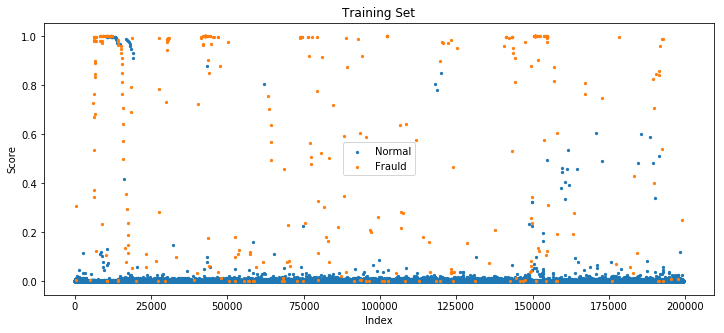

In [53]:
plt.figure(figsize = (12, 5))
plt.scatter(train_score.index[train_score['True_class'] == 0], 
            train_score[train_score['True_class'] == 0]['score'], 
            s = 5, label = 'Normal')
plt.scatter(train_score.index[train_score['True_class'] == 1], 
            train_score[train_score['True_class'] == 1]['score'], 
            s = 5, label = 'Frauld')
plt.xlabel('Index')
plt.ylabel('Score')
plt.title('Training Set')
plt.legend()
plt.show()


In [54]:
# Test set =================================================================
test_score = pd.DataFrame({'score': classifier.predict_proba(X_test)[:, 1], 
                           'True_class': y_test})
print(test_score.describe())


score    True_class
count  8.544300e+04  85443.000000
mean   1.494211e-03      0.001264
std    2.515924e-02      0.035531
min    9.306275e-12      0.000000
25%    1.297163e-04      0.000000
50%    2.688760e-04      0.000000
75%    5.815892e-04      0.000000
max    9.998761e-01      1.000000


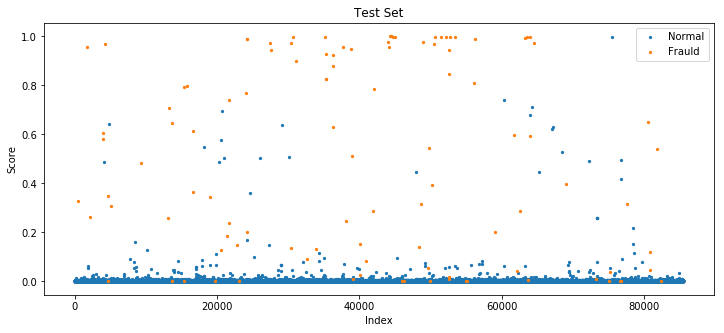

In [55]:
plt.figure(figsize = (12, 5))
plt.scatter(test_score.index[test_score['True_class'] == 0], 
            test_score[test_score['True_class'] == 0]['score'], 
            s = 5, label = 'Normal')
plt.scatter(test_score.index[test_score['True_class'] == 1], 
            test_score[test_score['True_class'] == 1]['score'], 
            s = 5, label = 'Frauld')
plt.xlabel('Index')
plt.ylabel('Score')
plt.title('Test Set')
plt.legend()
plt.show()


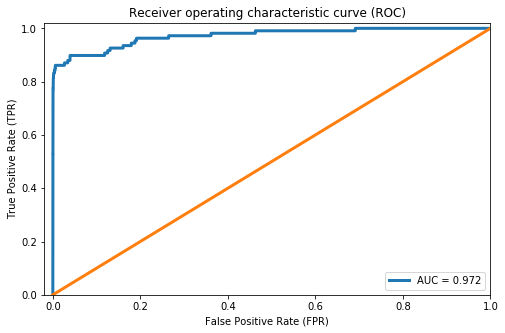

In [56]:
# ROC curve
fpr, tpr, thresholds = roc_curve(test_score.True_class, test_score.score)
roc_auc = auc(fpr, tpr)

plt.figure(figsize = (8, 5))
plt.plot(fpr, tpr, linewidth = 3, label = 'AUC = %0.3f' % (roc_auc))
plt.plot([0, 1], [0, 1], linewidth = 3)
plt.xlim(left = -0.02, right = 1)
plt.ylim(bottom = 0, top = 1.02)
plt.xlabel('False Positive Rate (FPR)')
plt.ylabel('True Positive Rate (TPR)')
plt.title('Receiver operating characteristic curve (ROC)')
plt.legend()
plt.show()


In [57]:
# Plotting the precision recall curve.
precision, recall, threshold = precision_recall_curve(test_score.True_class, test_score.score)
average_precision = average_precision_score(test_score.True_class, test_score.score)
f1_scores = 2 * precision * recall / (precision + recall)


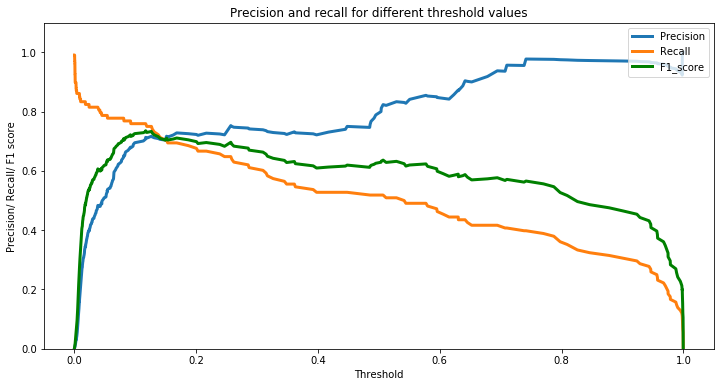

In [58]:
# Precision, Recall, F1 score curve 
plt.figure(figsize = (12, 6))
plt.plot(threshold, precision[1: ], label = "Precision", linewidth = 3)
plt.plot(threshold, recall[1: ], label ="Recall", linewidth = 3)
plt.plot(threshold, f1_scores[1: ], label = "F1_score", linewidth = 3, color = 'green')
plt.ylim(0, 1.1)
plt.xlabel('Threshold')
plt.ylabel('Precision/ Recall/ F1 score')
plt.title('Precision and recall for different threshold values')
plt.legend(loc = 'upper right')


In [59]:
print('Max F1 score = %.3f' % (f1_scores.max()))
print('Threshold = %.3f' % (threshold[f1_scores[1: ] == f1_scores.max()]))


Max F1 score = 0.735
Threshold = 0.117


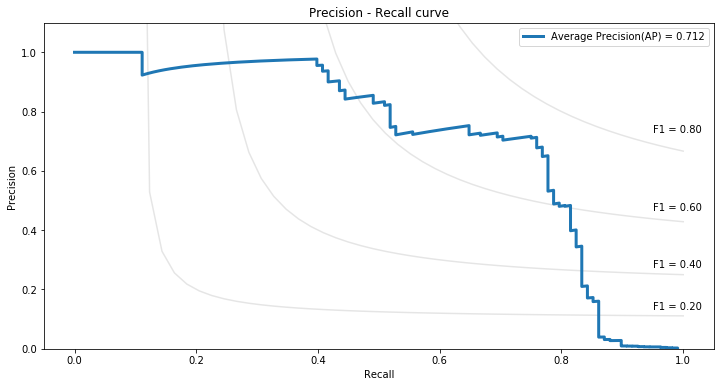

In [60]:
# Recall - Precision curve
plt.figure(figsize = (12, 6))
f_scores = np.linspace(0.2, 0.8, num = 4)
for f_score in f_scores:
    x = np.linspace(0.001, 1)
    y = f_score * x / (2 * x - f_score)
    plt.plot(x[y >= 0], y[y >= 0], color = 'gray', alpha = 0.2)
    plt.annotate('F1 = {0:0.2f}'.format(f_score), xy = (0.95, y[45] + 0.02))

plt.plot(recall[1: ], precision[1: ], 
         label = 'Average Precision(AP) = %0.3f' % (average_precision), 
         linewidth = 3)
plt.ylim(0, 1.1)
plt.xlabel('Recall')
plt.ylabel('Precision')
plt.title('Precision - Recall curve')
plt.legend(loc = 'upper right')
plt.show()


In [61]:
# Predicting the Test set
best_threshold = 0.117
y_test_score = classifier.predict_proba(X_test)[:, 1]
y_pred2 = y_test_score >= best_threshold


[[85301    34]
 [   26    82]]
accuracy = 0.9992977774656788
precision = 0.7068965517241379
recall = 0.7592592592592593
F1 score = 0.7321428571428572
              precision    recall  f1-score   support

           0       1.00      1.00      1.00     85335
           1       0.71      0.76      0.73       108

   micro avg       1.00      1.00      1.00     85443
   macro avg       0.85      0.88      0.87     85443
weighted avg       1.00      1.00      1.00     85443



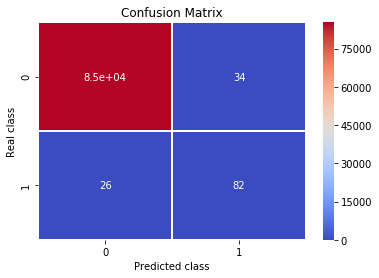

In [62]:
cm = confusion_matrix(y_test, y_pred2)
print(cm)
print('accuracy = {}'.format(accuracy_score(y_test, y_pred2)))
print('precision = {}'.format(precision_score(y_test, y_pred2)))
print('recall = {}'.format(recall_score(y_test, y_pred2)))
print('F1 score = {}'.format(f1_score(y_test, y_pred2)))
print(classification_report(y_test, y_pred2))

sns.heatmap(cm, cmap = "coolwarm", annot = True, linewidths = 0.5)
plt.title("Confusion Matrix")
plt.xlabel("Predicted class")
plt.ylabel("Real class")
plt.show()


In [63]:
def cross_val(clf, X, y, thresholds, n_splits = 5, plot_result = True):    
    F1_array = []
    Precision_array = []    
    Recall_array = []    
    # kf = KFold(n_splits = n_splits, random_state = 0)
    kf = StratifiedKFold(n_splits = n_splits, random_state = 0)
    i = 0
    for train_ind, val_ind in kf.split(X, y):        
        i = i + 1        
        a1 = []
        a2 = []
        a3 = []        
        X_train = X[train_ind]
        y_train = y[train_ind]        
        X_valid = X[val_ind]
        y_valid = y[val_ind]
        clf.fit(X_train, y_train)
        
        # Output scores
        y_valid_score = clf.predict_proba(X_valid)[:, 1]        
        
        # Test each thresholds and compute F1, Precisio, Recall        
        print('\nSplit {} ========================================='.format(i))
        for threshold in thresholds:             
            y_pred = y_valid_score >= threshold
            F1 = f1_score(y_valid, y_pred, average = 'binary')
            Precision = precision_score(y_valid, y_pred, average = 'binary')
            Recall = recall_score(y_valid, y_pred, average = 'binary')            
            a1.append(F1)
            a2.append(Precision)
            a3.append(Recall)
            print('-----------------------------------')   
            print('Threshold = %.3f' % (threshold))
            print('-----------------------------------')   
            print('F1 score = %.3f' % (F1))
            print('Precision = %.3f' % (Precision))
            print('Recall = %.3f' % (Recall))
            
        F1_array.append(a1)
        Precision_array.append(a2)
        Recall_array.append(a3)
    
    F1_array = np.array(F1_array)
    Precision_array = np.array(Precision_array)
    Recall_array = np.array(Recall_array)
    
    return Precision_array, Recall_array, F1_array    


In [64]:
classifier = LogisticRegression(solver = 'liblinear', random_state = 0)
n_splits = 5
thresholds = np.linspace(0.001, 0.99, 100)
Precision, Recall, F1_scores = cross_val(clf = classifier, X = X_train, y = y_train, 
                                         thresholds = thresholds, n_splits = n_splits)


------------------
F1 score = 0.643
Precision = 0.974
Recall = 0.481
-----------------------------------
Threshold = 0.580
-----------------------------------
F1 score = 0.643
Precision = 0.974
Recall = 0.481
-----------------------------------
Threshold = 0.590
-----------------------------------
F1 score = 0.643
Precision = 0.974
Recall = 0.481
-----------------------------------
Threshold = 0.600
-----------------------------------
F1 score = 0.643
Precision = 0.974
Recall = 0.481
-----------------------------------
Threshold = 0.610
-----------------------------------
F1 score = 0.643
Precision = 0.974
Recall = 0.481
-----------------------------------
Threshold = 0.620
-----------------------------------
F1 score = 0.643
Precision = 0.974
Recall = 0.481
-----------------------------------
Threshold = 0.630
-----------------------------------
F1 score = 0.643
Precision = 0.974
Recall = 0.481
-----------------------------------
Threshold = 0.640
-----------------------------------
F

In [65]:
def selectThresholdByCV(F1, Precision, Recall, Thresholds):    
    n_splits = F1_scores.shape[0]    
    f1_thres = F1.mean(axis = 0)
    precision_thres = Precision.mean(axis = 0)
    recall_thres = Recall.mean(axis = 0)
    
    # Find the maximun of f1 score
    best_index = np.where(f1_thres == f1_thres.max())
    
    # Find the threshold which maximizes the f1 score
    best_f1 = f1_thres[best_index]
    best_precision = precision_thres[best_index]
    best_recall = recall_thres[best_index]
    best_threshold = Thresholds[best_index]
    
    # Figures vs thresholds
    # F1 scores vs thresholds
    plt.figure(figsize = (12, 5))
    plt.xlim((np.min(thresholds) - 0.05, np.max(thresholds) + 0.05))
    plt.ylim((0, 1.1))
    plt.xlabel('Thresholds')
    plt.ylabel('F1 Scores')
    plt.title('{}-Fold Cross-Validated F1 scores'.format(n_splits))
    for ii in range(len(Thresholds)):
        plt.plot(np.repeat(Thresholds[ii], 2), [F1[:, ii].min(), F1[:, ii].max()], color = 'grey')
        plt.scatter(np.repeat(Thresholds[ii], n_splits), F1[:, ii], 
                    marker = '+', color = 'grey')        
    # plt.plot(Thresholds, f1_thres)
    plt.scatter(Thresholds, f1_thres, s = 30, color = 'red')
    plt.scatter(best_threshold, best_f1, 
                s = 80, facecolors = 'none', edgecolors = 'g', 
                label = 'Best F1 scoreCV = %.3f' % (best_f1))
    plt.axvline(best_threshold, linestyle = ':', color = 'g', 
                label = 'Best threshold = %.3f' % (best_threshold))
    plt.legend()
    plt.show()
    
    # Precision vs thresholds
    plt.figure(figsize = (12, 5))
    plt.xlim((np.min(thresholds) - 0.05, np.max(thresholds) + 0.05))
    plt.ylim((0, 1.1))
    plt.xlabel('Thresholds')
    plt.ylabel('Precision')
    plt.title('{}-Fold Cross-Validated Precision'.format(n_splits))
    for ii in range(len(Thresholds)):
        plt.plot(np.repeat(Thresholds[ii], 2), [Precision[:, ii].min(), Precision[:, ii].max()], color = 'grey')
        plt.scatter(np.repeat(Thresholds[ii], n_splits), Precision[:, ii], 
                    marker = '+', color = 'grey')        
    # plt.plot(Thresholds, precision_thres)
    plt.scatter(Thresholds, precision_thres, s = 30, color = 'red')
    plt.scatter(best_threshold, best_precision, 
                s = 80, facecolors = 'none', edgecolors = 'g', 
                label = 'Best PrecisionCV = %.3f' % (best_precision))
    plt.axvline(best_threshold, linestyle = ':', color = 'g', 
                label = 'Best threshold = %.3f' % (best_threshold))
    plt.legend()
    plt.show()
    
    # Recall vs thresholds
    plt.figure(figsize = (12, 5))
    plt.xlim((np.min(thresholds) - 0.05, np.max(thresholds) + 0.05))
    plt.ylim((0, 1.1))
    plt.xlabel('Thresholds')
    plt.ylabel('Recall')
    plt.title('{}-Fold Cross-Validated Recall'.format(n_splits))
    for ii in range(len(Thresholds)):
        plt.plot(np.repeat(Thresholds[ii], 2), [Recall[:, ii].min(), Recall[:, ii].max()], color = 'grey')
        plt.scatter(np.repeat(Thresholds[ii], n_splits), Recall[:, ii], 
                    marker = '+', color = 'grey')        
    # plt.plot(Thresholds, recall_thres)
    plt.scatter(Thresholds, recall_thres, s = 30, color = 'red')
    plt.scatter(best_threshold, best_recall, 
                s = 80, facecolors = 'none', edgecolors = 'g', 
                label = 'Best RecallCV = %.3f' % (best_recall))
    plt.axvline(best_threshold, linestyle = ':', color = 'g', 
                label = 'Best threshold = %.3f' % (best_threshold))
    plt.legend()
    plt.show()
    
    return best_f1, best_precision, best_recall, best_threshold
    

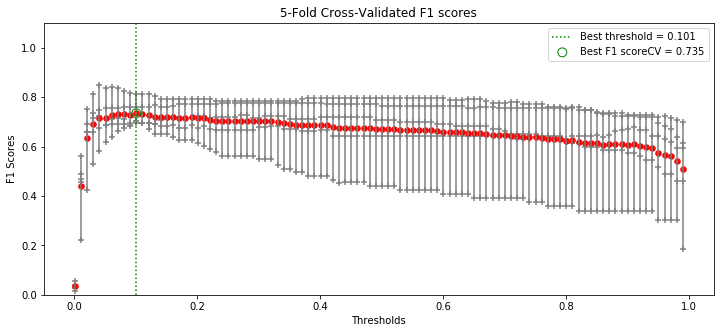

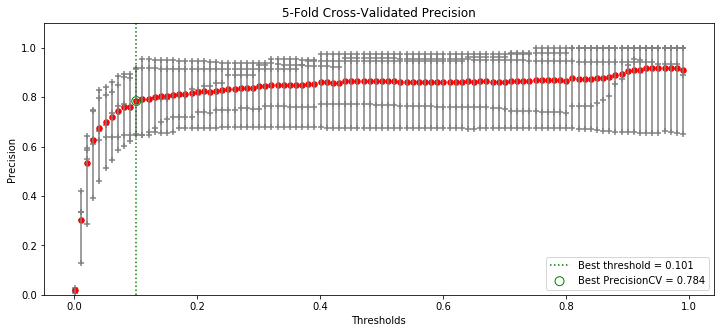

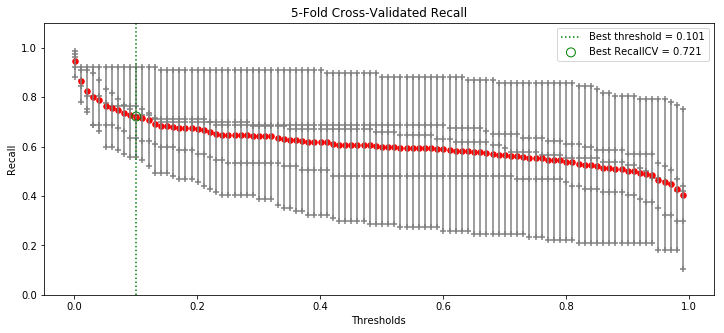

In [66]:
best_f1, best_precision, best_recall, best_threshold = selectThresholdByCV(F1 = F1_scores, 
                                                                           Precision = Precision, 
                                                                           Recall = Recall, 
                                                                           Thresholds = thresholds)


In [67]:
print('Best threshold = %.3f' % (best_threshold))
print('F1 score CV = %.3f' % (best_f1))
print('Precision CV = %.3f' % (best_precision))
print('Recall CV = %.3f' % (best_recall))


Best threshold = 0.101
F1 score CV = 0.735
Precision CV = 0.784
Recall CV = 0.721


In [68]:
classifier = LogisticRegression(solver = 'liblinear', random_state = 0)
classifier.fit(X_train, y_train)

LogisticRegression(C=1.0, class_weight=None, dual=False, fit_intercept=True,
          intercept_scaling=1, max_iter=100, multi_class='warn',
          n_jobs=None, penalty='l2', random_state=0, solver='liblinear',
          tol=0.0001, verbose=0, warm_start=False)

In [69]:
# Predicting the Test set
y_test_score = classifier.predict_proba(X_test)[:, 1]
y_pred = (y_test_score >= best_threshold)

[[85299    36]
 [   26    82]]
accuracy = 0.9992743700478681
precision = 0.6949152542372882
recall = 0.7592592592592593
F1 score = 0.7256637168141593
              precision    recall  f1-score   support

           0       1.00      1.00      1.00     85335
           1       0.69      0.76      0.73       108

   micro avg       1.00      1.00      1.00     85443
   macro avg       0.85      0.88      0.86     85443
weighted avg       1.00      1.00      1.00     85443



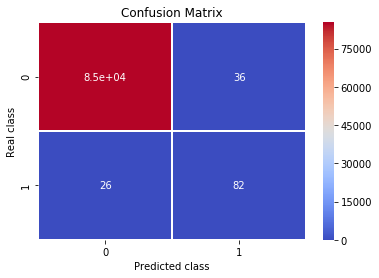

In [70]:
cm = confusion_matrix(y_test, y_pred)
print(cm)
print('accuracy = {}'.format(accuracy_score(y_test, y_pred)))
print('precision = {}'.format(precision_score(y_test, y_pred)))
print('recall = {}'.format(recall_score(y_test, y_pred)))
print('F1 score = {}'.format(f1_score(y_test, y_pred)))
print(classification_report(y_test, y_pred))

sns.heatmap(cm, cmap = "coolwarm", annot = True, linewidths = 0.5)
plt.title("Confusion Matrix")
plt.xlabel("Predicted class")
plt.ylabel("Real class")
plt.show()
